In [2]:
#** Import numpy and pandas **
import numpy as np
import pandas as pd

In [3]:
#** Import visualization libraries and set %matplotlib inline. **
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

In [4]:
#** Read in the csv file as a dataframe called df **
df=pd.read_csv('911.csv')

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 663522 entries, 0 to 663521
Data columns (total 9 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   lat        663522 non-null  float64
 1   lng        663522 non-null  float64
 2   desc       663522 non-null  object 
 3   zip        583323 non-null  float64
 4   title      663522 non-null  object 
 5   timeStamp  663522 non-null  object 
 6   twp        663229 non-null  object 
 7   addr       663522 non-null  object 
 8   e          663522 non-null  int64  
dtypes: float64(3), int64(1), object(5)
memory usage: 45.6+ MB


In [6]:
df.describe()

,lat,lng,zip,e
count,663522.000000,663522.000000,583323.000000,663522.0
mean,40.158162,-75.300105,19236.055791,1.0
std,0.220641,1.672884,298.222637,0.0
min,0.000000,-119.698206,1104.000000,1.0
25%,40.100344,-75.392735,19038.000000,1.0
50%,40.143927,-75.305143,19401.000000,1.0
75%,40.229008,-75.211865,19446.000000,1.0
max,51.335390,87.854975,77316.000000,1.0


In [7]:
df.head()

,lat,lng,desc,zip,title,timeStamp,twp,addr,e
0,40.297876,-75.581294,REINDEER CT & DEAD END; NEW HANOVER; Station ...,19525.0,EMS: BACK PAINS/INJURY,2015-12-10 17:10:52,NEW HANOVER,REINDEER CT & DEAD END,1
1,40.258061,-75.264680,BRIAR PATH & WHITEMARSH LN; HATFIELD TOWNSHIP...,19446.0,EMS: DIABETIC EMERGENCY,2015-12-10 17:29:21,HATFIELD TOWNSHIP,BRIAR PATH & WHITEMARSH LN,1
2,40.121182,-75.351975,HAWS AVE; NORRISTOWN; 2015-12-10 @ 14:39:21-St...,19401.0,Fire: GAS-ODOR/LEAK,2015-12-10 14:39:21,NORRISTOWN,HAWS AVE,1
3,40.116153,-75.343513,AIRY ST & SWEDE ST; NORRISTOWN; Station 308A;...,19401.0,EMS: CARDIAC EMERGENCY,2015-12-10 16:47:36,NORRISTOWN,AIRY ST & SWEDE ST,1
4,40.251492,-75.603350,CHERRYWOOD CT & DEAD END; LOWER POTTSGROVE; S...,NaN,EMS: DIZZINESS,2015-12-10 16:56:52,LOWER POTTSGROVE,CHERRYWOOD CT & DEAD END,1


In [8]:
df.nunique()

lat           25949
lng           25980
desc         663282
zip             204
title           148
timeStamp    640754
twp              68
addr          41292
e                 1
dtype: int64

In [9]:
zipcode=df.groupby('zip')
sortedzip=zipcode.count().sort_values(by='lat',ascending=False)
sortedzip['lat'].head(5)

zip
19401.0    45606
19464.0    43910
19403.0    34888
19446.0    32270
19406.0    22464
Name: lat, dtype: int64

In [10]:
town=df.groupby('twp')
sortedtown=town.count().sort_values(by='lat',ascending=False)
sortedtown['lat'].head(5)

twp
LOWER MERION    55490
ABINGTON        39947
NORRISTOWN      37633
UPPER MERION    36010
CHELTENHAM      30574
Name: lat, dtype: int64

In [11]:
title=df['title'].unique()
len(title)

148

In [12]:
most_common_calls = df.groupby('title').count().sort_values(by='lat',ascending=False)['lat'].head(5)

<Axes: xlabel='title', ylabel='count'>

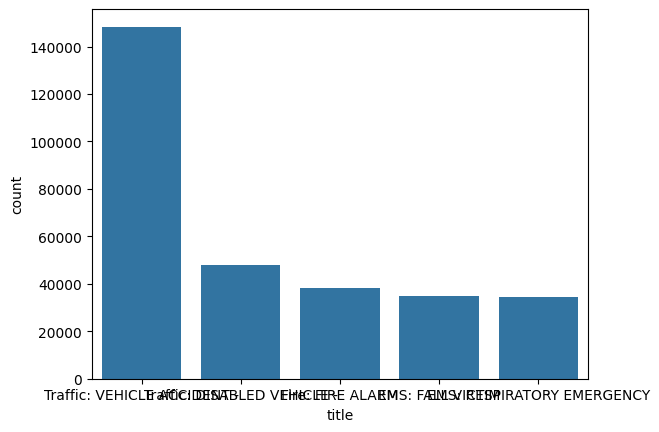

In [13]:
sns.countplot(x='title',data=df,order=most_common_calls.index)

C:\Users\Deep\AppData\Local\Temp\ipykernel_33064\1470674379.py:1: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x='title',data=df,order=most_common_calls.index,palette='viridis')


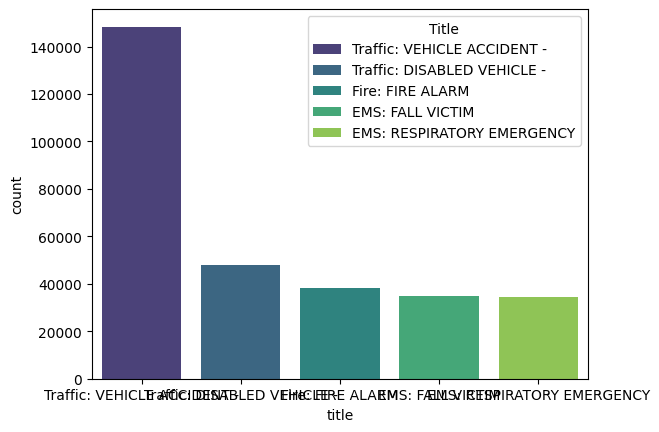

In [14]:
sns.countplot(x='title',data=df,order=most_common_calls.index,palette='viridis')
plt.legend(title='Title', labels=most_common_calls.index, loc='upper right')

In [17]:
df['Reason']=df['title'].apply(lambda x:x.split(":")[0])
df

,lat,lng,desc,zip,title,timeStamp,twp,addr,e,Reason
0,40.297876,-75.581294,REINDEER CT & DEAD END; NEW HANOVER; Station ...,19525.0,EMS: BACK PAINS/INJURY,2015-12-10 17:10:52,NEW HANOVER,REINDEER CT & DEAD END,1,EMS
1,40.258061,-75.264680,BRIAR PATH & WHITEMARSH LN; HATFIELD TOWNSHIP...,19446.0,EMS: DIABETIC EMERGENCY,2015-12-10 17:29:21,HATFIELD TOWNSHIP,BRIAR PATH & WHITEMARSH LN,1,EMS
2,40.121182,-75.351975,HAWS AVE; NORRISTOWN; 2015-12-10 @ 14:39:21-St...,19401.0,Fire: GAS-ODOR/LEAK,2015-12-10 14:39:21,NORRISTOWN,HAWS AVE,1,Fire
3,40.116153,-75.343513,AIRY ST & SWEDE ST; NORRISTOWN; Station 308A;...,19401.0,EMS: CARDIAC EMERGENCY,2015-12-10 16:47:36,NORRISTOWN,AIRY ST & SWEDE ST,1,EMS
4,40.251492,-75.603350,CHERRYWOOD CT & DEAD END; LOWER POTTSGROVE; S...,NaN,EMS: DIZZINESS,2015-12-10 16:56:52,LOWER POTTSGROVE,CHERRYWOOD CT & DEAD END,1,EMS
...,...,...,...,...,...,...,...,...,...,...
663517,40.157956,-75.348060,SUNSET AVE & WOODLAND AVE; EAST NORRITON; 2020...,19403.0,Traffic: VEHICLE ACCIDENT -,2020-07-29 15:46:51,EAST NORRITON,SUNSET AVE & WOODLAND AVE,1,Traffic
663518,40.136306,-75.428697,EAGLEVILLE RD & BUNTING CIR; LOWER PROVIDENCE...,19403.0,EMS: GENERAL WEAKNESS,2020-07-29 15:52:19,LOWER PROVIDENCE,EAGLEVILLE RD & BUNTING CIR,1,EMS
663519,40.013779,-75.300835,HAVERFORD STATION RD; LOWER MERION; Station 3...,19041.0,EMS: VEHICLE ACCIDENT,2020-07-29 15:52:52,LOWER MERION,HAVERFORD STATION RD,1,EMS
663520,40.121603,-75.351437,MARSHALL ST & HAWS AVE; NORRISTOWN; 2020-07-29...,19401.0,Fire: BUILDING FIRE,2020-07-29 15:54:08,NORRISTOWN,MARSHALL ST & HAWS AVE,1,Fire


In [18]:
reasons=df.groupby('Reason')
countedreason=reasons.count()
countedreason['lat']

Reason
EMS        332692
Fire       100622
Traffic    230208
Name: lat, dtype: int64

C:\Users\Deep\AppData\Local\Temp\ipykernel_6916\3229167806.py:1: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(df['Reason'], palette='viridis', order=['EMS','Traffic','Fire'])


<Axes: xlabel='count', ylabel='Reason'>

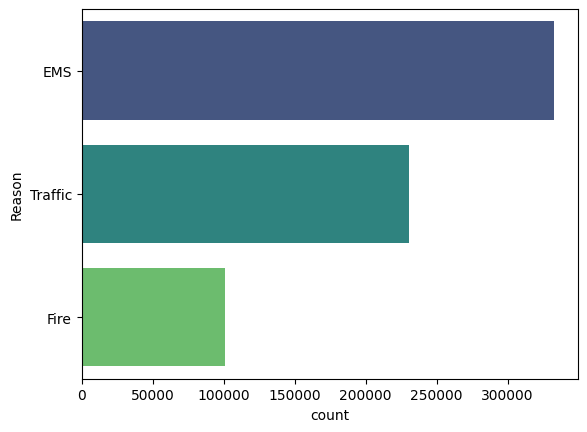

In [19]:
sns.countplot(df['Reason'], palette='viridis', order=['EMS','Traffic','Fire'])
#highest calls were regarding EMS or emergenct

In [20]:
df['timeStamp']=pd.to_datetime(df['timeStamp'])

In [21]:
time = df['timeStamp'].iloc[0]
time

Timestamp('2015-12-10 17:10:52')

In [22]:
df['Hour']=df['timeStamp'].apply(lambda x:x.hour)
df['Month']=df['timeStamp'].apply(lambda x:x.month)
df["Month"] = df["Month"].map({1: 'Jan', 2: 'Feb', 3: 'Mar', 4: 'Apr', 5: 'May', 6: 'Jun', 7: 'Jul', 8: 'Aug', 9: 'Sep', 10: 'Oct', 11: 'Nov', 12: 'Dec'})
df['Day of week']=df['timeStamp'].apply(lambda x:x.dayofweek)
df['Day of week'] = df['Day of week'].map({0: 'Mon', 1: 'Tue', 2: 'Wed', 3: 'Thu', 4: 'Fri', 5: 'Sat', 6: 'Sun'})

In [24]:
day_of_week = df["Day of week"].groupby(df["Day of week"]).count()

C:\Users\Deep\AppData\Local\Temp\ipykernel_6916\3583006290.py:1: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=day_of_week.index, y=day_of_week.values, order=['Mon', 'Tue', 'Wed', 'Thu', 'Fri', 'Sat', 'Sun'], palette='viridis')


<Axes: xlabel='Day of week'>

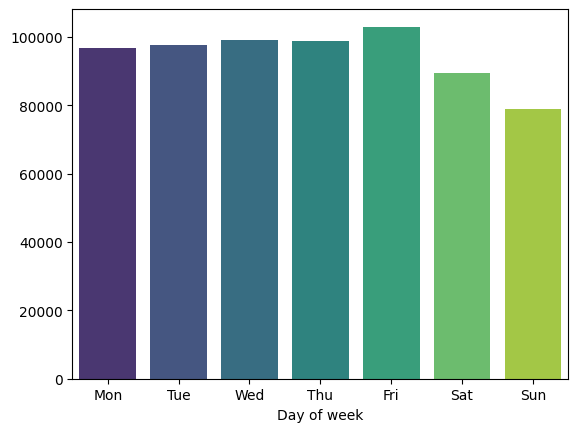

In [25]:
sns.barplot(x=day_of_week.index, y=day_of_week.values, order=['Mon', 'Tue', 'Wed', 'Thu', 'Fri', 'Sat', 'Sun'], palette='viridis')

In [26]:
print(day_of_week.idxmax())
#highest calls were recorded on Friday

Fri


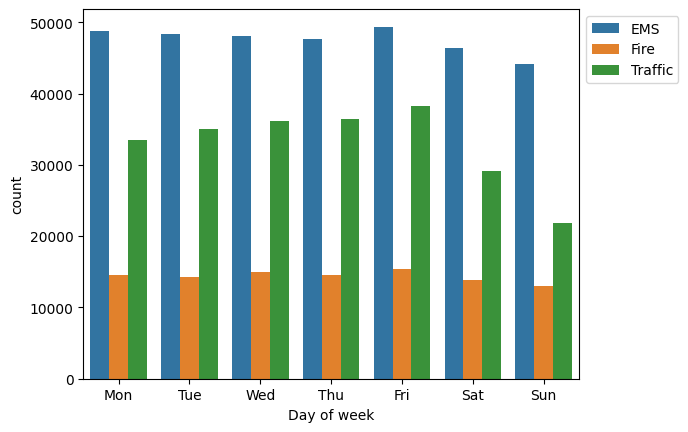

In [27]:
sns.countplot(x=df['Day of week'], hue=df['Reason'], order=['Mon','Tue','Wed','Thu','Fri','Sat','Sun'])
plt.legend(bbox_to_anchor=(1,1))

C:\Users\Deep\AppData\Local\Temp\ipykernel_6916\335108330.py:1: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x=df['Month'], palette='viridis', order=['Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov','Dec'])
C:\Users\Deep\AppData\Local\Temp\ipykernel_6916\335108330.py:2: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1,1))


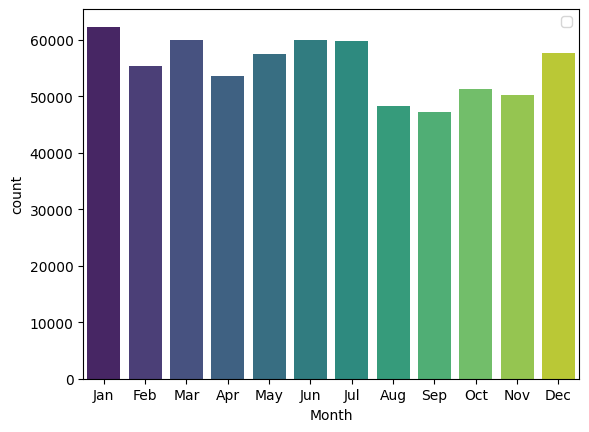

In [28]:
sns.countplot(x=df['Month'], palette='viridis', order=['Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov','Dec'])
plt.legend(bbox_to_anchor=(1,1))

Maximum Calls were obtained in January

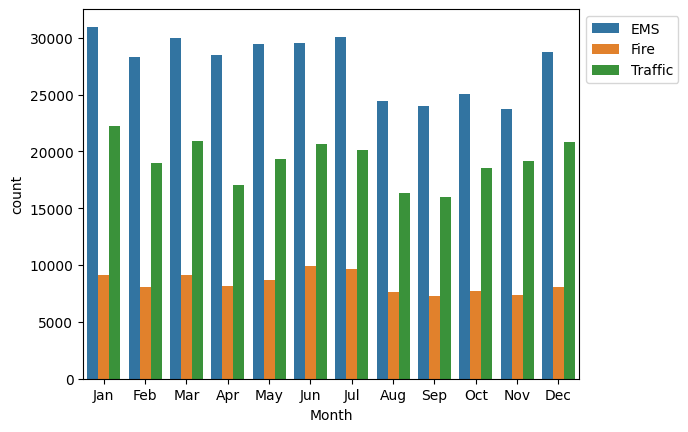

In [29]:
sns.countplot(x=df['Month'], hue=df['Reason'], order=['Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov','Dec'])
plt.legend(bbox_to_anchor=(1,1))

In [30]:
df['Year']=df['timeStamp'].apply(lambda x:x.year)

C:\Users\Deep\AppData\Local\Temp\ipykernel_6916\2414763487.py:1: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x=df['Year'], palette='viridis')


<Axes: xlabel='Year', ylabel='count'>

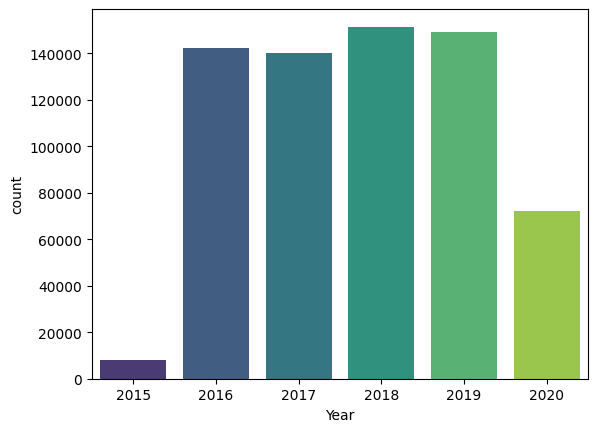

In [31]:
sns.countplot(x=df['Year'], palette='viridis')

In [32]:
dayhour = df.groupby(by = ['Day of week','Hour']).count() ['Reason'].unstack()

In [33]:
dayhour

Hour,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
Day of week,,,,,,,,,,,,,,,,,,,,,
Fri,1983,1635,1449,1296,1339,1639,2670,4143,5018,5288,...,6394,7040,7065,7113,5668,5056,4375,3913,3422,2834
Mon,1894,1571,1368,1272,1336,1844,2675,4430,5504,5724,...,5713,6289,6346,6408,5441,4488,3823,3254,2658,2072
Sat,2447,2059,1883,1592,1451,1580,1880,2489,3457,4315,...,5421,5181,5211,5213,4980,4753,4127,3895,3226,2965
Sun,2424,2135,1946,1614,1471,1488,1726,2408,3001,3728,...,4744,4475,4560,4505,4402,4135,3748,3161,2629,2323
Thu,1731,1408,1426,1236,1293,1775,2816,4432,5297,5412,...,6079,6493,6375,6935,5512,4703,4045,3490,2844,2354
Tue,1720,1459,1322,1213,1247,1741,2784,4425,5634,5566,...,5926,6252,6495,6883,5628,4621,3845,3409,2708,2137
Wed,1664,1484,1259,1265,1128,1609,2668,4644,5469,5444,...,6069,6533,6745,7062,5691,4686,4116,3537,2826,2207


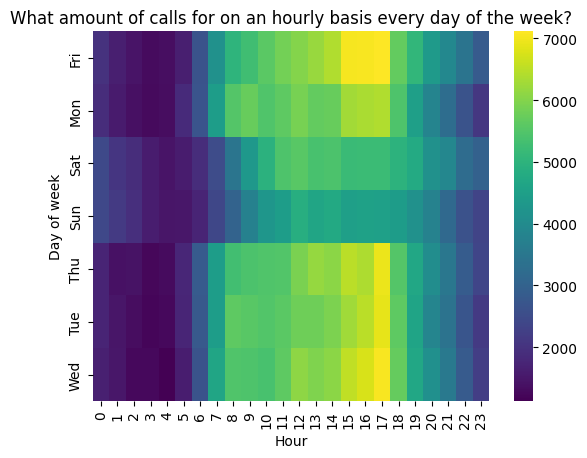

In [34]:
sns.heatmap(dayhour, cmap='viridis')
plt.title('What amount of calls for on an hourly basis every day of the week?')
plt.show()

<Axes: xlabel='Hour', ylabel='count'>

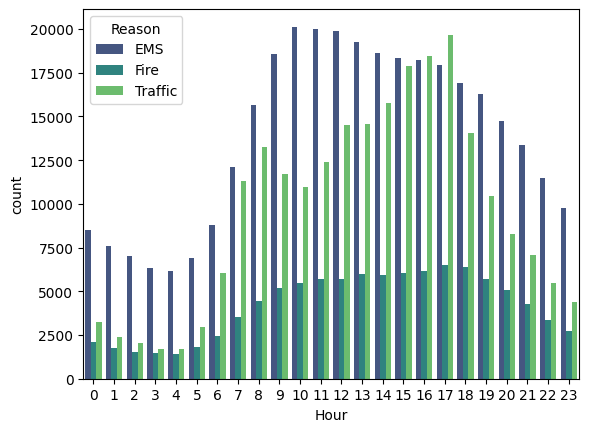

In [35]:
sns.countplot(x=df['Hour'], palette='viridis', order=range(0,24), hue=df['Reason'])

In [36]:
import plotly.express as px
fig = px.scatter_mapbox(df, lat="lat", lon="lng", color="Reason", 
                        color_discrete_map={"EMS": "red", "Traffic": "blue", "Fire": "green"},
                        zoom=3, mapbox_style="carto-positron")

# Show the plot

In [37]:
fig

In [38]:
most_common_calls_ems = df[df['Reason']=='EMS'].groupby('title').count().sort_values(by='lat',ascending=False)['lat'].head(5)
most_common_calls_traffic = df[df['Reason']=='Traffic'].groupby('title').count().sort_values(by='lat',ascending=False)['lat'].head(5)
most_common_calls_fire = df[df['Reason']=='Fire'].groupby('title').count().sort_values(by='lat',ascending=False)['lat'].head(5)

C:\Users\Deep\AppData\Local\Temp\ipykernel_6916\3787485574.py:1: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




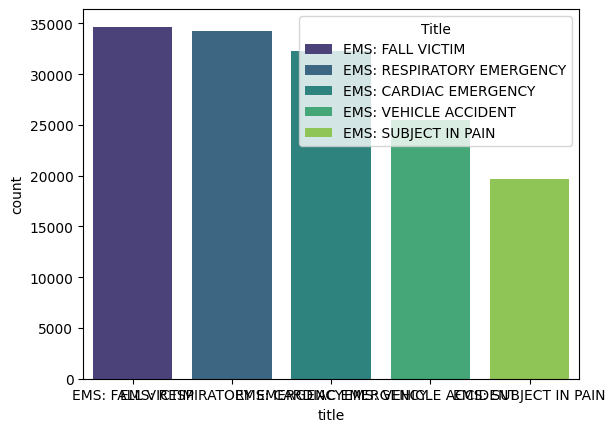

In [46]:
sns.countplot(x='title',data=df,order=most_common_calls_ems.index,palette='viridis')
plt.legend(title='Title', labels=most_common_calls_ems.index, loc='upper right')

In [38]:
most_common_calls_ems

title
EMS: FALL VICTIM              34676
EMS: RESPIRATORY EMERGENCY    34248
EMS: CARDIAC EMERGENCY        32332
EMS: VEHICLE ACCIDENT         25513
EMS: SUBJECT IN PAIN          19646
Name: lat, dtype: int64

C:\Users\Deep\AppData\Local\Temp\ipykernel_6916\1636435222.py:1: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




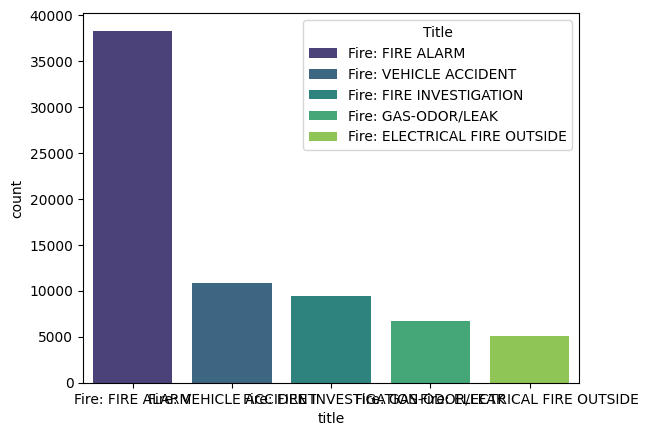

In [47]:
sns.countplot(x='title',data=df,order=most_common_calls_fire.index,palette='viridis')
plt.legend(title='Title', labels=most_common_calls_fire.index, loc='upper right')

In [39]:
most_common_calls_fire

title
Fire: FIRE ALARM                 38336
Fire: VEHICLE ACCIDENT           10864
Fire: FIRE INVESTIGATION          9444
Fire: GAS-ODOR/LEAK               6740
Fire: ELECTRICAL FIRE OUTSIDE     5111
Name: lat, dtype: int64

C:\Users\Deep\AppData\Local\Temp\ipykernel_6916\788197298.py:1: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




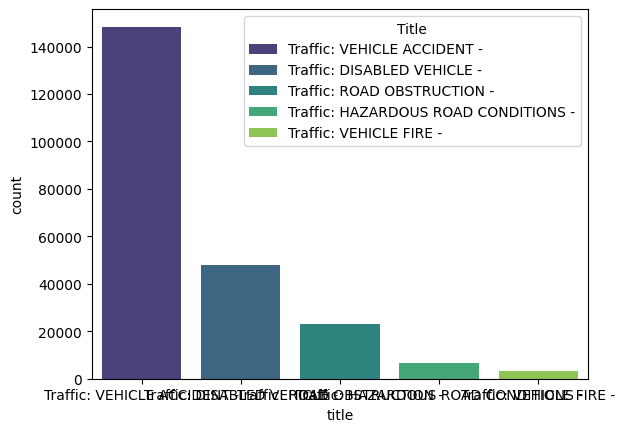

In [48]:
sns.countplot(x='title',data=df,order=most_common_calls_traffic.index,palette='viridis')
plt.legend(title='Title', labels=most_common_calls_traffic.index, loc='upper right')

In [40]:
most_common_calls_traffic

title
Traffic: VEHICLE ACCIDENT -             148372
Traffic: DISABLED VEHICLE -              47909
Traffic: ROAD OBSTRUCTION -              23235
Traffic: HAZARDOUS ROAD CONDITIONS -      6833
Traffic: VEHICLE FIRE -                   3366
Name: lat, dtype: int64

In [43]:
lower_merion_df = df[df['twp']=='LOWER MERION']
reason_counts = lower_merion_df['Reason'].value_counts()

print(reason_counts)

Reason
Traffic    23758
EMS        21578
Fire       10154
Name: count, dtype: int64


C:\Users\Deep\AppData\Local\Temp\ipykernel_6916\1259122683.py:1: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




<Axes: xlabel='Reason', ylabel='count'>

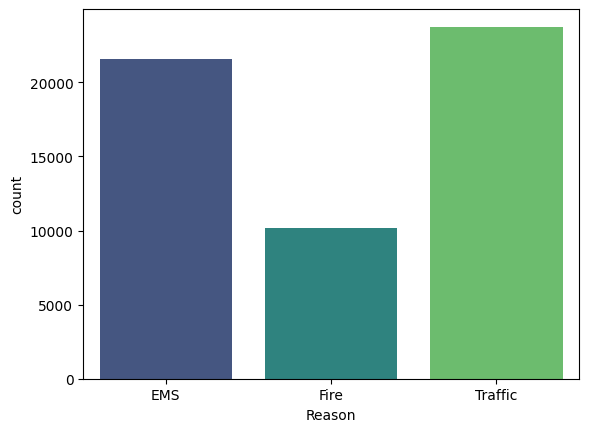

In [50]:
sns.countplot(x='Reason',data=lower_merion_df,palette='viridis')

In [42]:
'''Conclusions of Data Analysis:
1. Traffic calls are most frequent during 5 PM.

2. January Sees the most amount of calls.

3. Highest Calls are about EMS followed by traffic and then fire.

4. Most Calls are observed on Friday

5. Emergency for week days have a peak rate in between 10 pm to 6 am where as  for week ends it is in between 12 pm to 8 am

6. Top 5 reasons for 911 calls were:

    Traffic: VEHICLE ACCIDENT -    148372
    Traffic: DISABLED VEHICLE -     47909
    Fire: FIRE ALARM                38336
    EMS: FALL VICTIM                34676
    EMS: RESPIRATORY EMERGENCY      34248

7.The data for 911 calls is focused for regions near philadelpia only with some scattered datapoints around the country.

8. Most calls for EMS were of:

EMS: FALL VICTIM              34676
EMS: RESPIRATORY EMERGENCY    34248
EMS: CARDIAC EMERGENCY        32332
EMS: VEHICLE ACCIDENT         25513
EMS: SUBJECT IN PAIN          19646

Health issues are majority for Respiratory emergency and Cardiac emergency.

9. Most calls for fire were of:

Fire: FIRE ALARM                 38336
Fire: VEHICLE ACCIDENT           10864
Fire: FIRE INVESTIGATION          9444
Fire: GAS-ODOR/LEAK               6740
Fire: ELECTRICAL FIRE OUTSIDE     5111

Fire issues are majority of Fire alarm going of followed by fire by Vehicle accidents.

10. Most calls for Traffic were of:

Traffic: VEHICLE ACCIDENT -             148372
Traffic: DISABLED VEHICLE -              47909
Traffic: ROAD OBSTRUCTION -              23235
Traffic: HAZARDOUS ROAD CONDITIONS -      6833
Traffic: VEHICLE FIRE -                   3366

Traffic issues majority include problems with Vehicle accidents with about 1.5 lakh calls followed by disabled vehicles.

11. Most calls count as per towns are:

LOWER MERION    55490
ABINGTON        39947
NORRISTOWN      37633
UPPER MERION    36010
CHELTENHAM      30574

12. Lower Merion has most calls for:

Traffic    23758
EMS        21578
Fire       10154

'''

'Conclusions of Data Analysis:\n1. Traffic calls are most frequent during 5 PM.\n\n2. January Sees the most amount of calls.\n\n3. Highest Calls are about EMS followed by traffic and then fire.\n\n4. Most Calls are observed on Friday\n\n5. Emergency for week days have a peak rate in between 10 pm to 6 am where as  for week ends it is in between 12 pm to 8 am\n\n6. Top 5 reasons for 911 calls were:\n\n    Traffic: VEHICLE ACCIDENT -    148372\n    Traffic: DISABLED VEHICLE -     47909\n    Fire: FIRE ALARM                38336\n    EMS: FALL VICTIM                34676\n    EMS: RESPIRATORY EMERGENCY      34248\n\n7.The data for 911 calls is focused for regions near philadelpia only with some scattered datapoints around the country.\n\n8. Most calls for EMS were of:\n\nEMS: FALL VICTIM              34676\nEMS: RESPIRATORY EMERGENCY    34248\nEMS: CARDIAC EMERGENCY        32332\nEMS: VEHICLE ACCIDENT         25513\nEMS: SUBJECT IN PAIN          19646\n\nHealth issues are majority for Res